## Рынок заведений общественного питания Москвы

## Описание проекта

**Инвесторы из фонда «Shut Up and Take My Money» решили попробовать себя в новой области и открыть заведение общественного питания в Москве. Заказчики ещё не знают, что это будет за место: кафе, ресторан, пиццерия, паб или бар, — и какими будут расположение, меню и цены.
Для начала они просят вас — аналитика — подготовить исследование рынка Москвы, найти интересные особенности и презентовать полученные результаты, которые в будущем помогут в выборе подходящего инвесторам места.**

## Описание данных

## Общая информацию

In [1]:
import pandas as pd
import numpy as np
import datetime as dt
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
from folium import Map, Choropleth, Marker
from folium.plugins import MarkerCluster

In [3]:
rest.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8406 entries, 0 to 8405
Data columns (total 14 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               8406 non-null   object 
 1   category           8406 non-null   object 
 2   address            8406 non-null   object 
 3   district           8406 non-null   object 
 4   hours              7870 non-null   object 
 5   lat                8406 non-null   float64
 6   lng                8406 non-null   float64
 7   rating             8406 non-null   float64
 8   price              3315 non-null   object 
 9   avg_bill           3816 non-null   object 
 10  middle_avg_bill    3149 non-null   float64
 11  middle_coffee_cup  535 non-null    float64
 12  chain              8406 non-null   int64  
 13  seats              4795 non-null   float64
dtypes: float64(6), int64(1), object(7)
memory usage: 919.5+ KB


In [4]:
display(rest.duplicated().sum())
display(rest.duplicated(subset=['name','address']).sum())
rest = rest.drop_duplicates(subset=['name','address'])
rest.count()

0

0

name                 8406
category             8406
address              8406
district             8406
hours                7870
lat                  8406
lng                  8406
rating               8406
price                3315
avg_bill             3816
middle_avg_bill      3149
middle_coffee_cup     535
chain                8406
seats                4795
dtype: int64

In [5]:
print('Кол-во заведений в Москве',rest['name'].nunique())

Кол-во заведений в Москве 5614


In [6]:
rest['name'] = rest['name'].str.lower()
rest['address'] = rest['address'].str.lower()
rest['district'] = rest['district'].str.lower()

**Имеется 8406 строк, всего заведений у нас 5614, видно что больше всего присутствуют кафе и рестораны, явных дубликатов не обнаружено, Однако есть 4 заведения у которых идентицны названия и адреса их мы удалим, имеются пропуски в данных, им много удалять такие строчки ее стоит иначе исказится картина,  типы данных соотетствуют нормальным.**

##  Выполните предобработку данных

In [7]:
rest_1 = rest.loc[rest['seats'] > 500]
rest = rest.query('index not in @rest_1.index')

**Оставили заведения с кол-вом посадочных мест не более 500, что делать с avg_bill не понятно его наверное стоит не заполнять, остальные же поля прямо исходят из него и тем самым заполнить их тоже непонятно как, в данном случае стоит лучше оставить их пропущенными**

In [8]:
rest['street'] = rest['address'].str.split(', ').str[1] # работает ли ресторна круглые сутки
rest['is_24/7'] = rest['hours'].str.contains('ежедневно, круглосуточно')
rest[rest['is_24/7']== True]

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24/7
10,great room bar,"бар,паб","москва, левобережная улица, 12",северный административный округ,"ежедневно, круглосуточно",55.877832,37.469171,4.5,средние,Цена бокала пива:250–350 ₽,NaN,NaN,0,102.0,левобережная улица,True
17,чайхана беш-бармак,ресторан,"москва, ленинградское шоссе, 71б, стр. 2",северный административный округ,"ежедневно, круглосуточно",55.876908,37.449876,4.4,средние,Средний счёт:350–500 ₽,425.0,NaN,0,96.0,ленинградское шоссе,True
19,пекарня,булочная,"москва, ижорский проезд, 5",северный административный округ,"ежедневно, круглосуточно",55.887969,37.515688,4.4,NaN,NaN,NaN,NaN,1,NaN,ижорский проезд,True
24,drive café,кафе,"москва, улица дыбенко, 9ас1",северный административный округ,"ежедневно, круглосуточно",55.879992,37.481571,4.0,NaN,NaN,NaN,NaN,1,NaN,улица дыбенко,True
49,2u-ту-ю,пиццерия,"москва, ижорская улица, 8а",северный административный округ,"ежедневно, круглосуточно",55.886160,37.508784,2.7,NaN,Средний счёт:900 ₽,900.0,NaN,0,NaN,ижорская улица,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8394,намангале,кафе,"москва, ферганская улица, вл17-21",юго-восточный административный округ,"ежедневно, круглосуточно",55.705332,37.819244,4.3,NaN,NaN,NaN,NaN,0,NaN,ферганская улица,True
8399,"пекарня, кафе-гриль",булочная,"москва, болотниковская улица, 52, корп. 2",юго-западный административный округ,"ежедневно, круглосуточно",55.662866,37.582572,4.2,NaN,Средний счёт:50–250 ₽,150.0,NaN,0,50.0,болотниковская улица,True
8403,самовар,кафе,"москва, люблинская улица, 112а, стр. 1",юго-восточный административный округ,"ежедневно, круглосуточно",55.648859,37.743219,3.9,NaN,Средний счёт:от 150 ₽,150.0,NaN,0,150.0,люблинская улица,True
8404,чайхана sabr,кафе,"москва, люблинская улица, 112а, стр. 1",юго-восточный административный округ,"ежедневно, круглосуточно",55.648849,37.743222,4.2,NaN,NaN,NaN,NaN,1,150.0,люблинская улица,True


## Анализ данных

### Какие категории заведений представлены в данных? Исследуйте количество объектов общественного питания по категориям: рестораны, кофейни, пиццерии, бары и так далее. Постройте визуализации. Ответьте на вопрос о распределении заведений по категориям.

In [9]:
print('категории заведений в Москве:',rest['category'].unique())

категории заведений в Москве: ['кафе' 'ресторан' 'кофейня' 'пиццерия' 'бар,паб' 'быстрое питание'
 'булочная' 'столовая']


In [10]:
rest_cat = rest.groupby('category')['name'].count().reset_index().\
    sort_values(by = 'name', ascending = False)
rest_cat.columns = ['category', 'count']
rest_cat

,category,count
3,кафе,2364
6,ресторан,2031
4,кофейня,1401
0,"бар,паб",755
5,пиццерия,629
2,быстрое питание,602
7,столовая,313
1,булочная,255


In [11]:
fig = go.Figure(data = [go.Pie(labels = rest_cat['category'], values = rest_cat['count'],
                               title = 'Распределение общепита по категориям и кол-ву')])

fig.show()

**Невооруженным взглядом видно, что лидерами в категориях являюется кафе с 2364 точками и рестораны с 2031 точками. На них приходится более 50% все заведений. меньше всего же столовые и булочные из всего 6 %.**

### Исследуйте количество посадочных мест в местах по категориям: рестораны, кофейни, пиццерии, бары и так далее. Постройте визуализации. Проанализируйте результаты и сделайте выводы.

In [12]:
rest_seats = rest.groupby('category')['seats'].median().reset_index().\
    sort_values(by = 'seats', ascending = False)
rest_seats

,category,seats
6,ресторан,86.0
0,"бар,паб",80.0
4,кофейня,78.0
7,столовая,75.0
2,быстрое питание,65.0
3,кафе,60.0
5,пиццерия,52.0
1,булочная,50.0


In [13]:
fig = px.bar(rest_seats, x = 'category', y = 'seats',\
             title = 'Распределение мест по виду заведения',\
             color = 'category'\
            )
fig.show()

**Видно, что больше всего мест в ресторане и пабах, на это есть 2 причины. ВО первых на эти 2 типа заведений приходится более 40% всех заведений Москвы. ВО вторых там мест изначально больше ведь они расчитаны на более длительное время гостя, а не на быстрый перекус как в иных объектах**

### Рассмотрите и изобразите соотношение сетевых и несетевых заведений в датасете. Каких заведений больше?

In [14]:
rest_chain = rest.groupby('chain')['name'].count().rename(index = {0:'Не_сетка',1:'Сетка'}).reset_index()
rest_chain.columns = ['chain', 'count']
rest_chain

,chain,count
0,Не_сетка,5171
1,Сетка,3179


In [15]:
fig = go.Figure(data = [go.Pie(labels = rest_chain['chain'], values = rest_chain['count'],
                               title = 'Распределение общепита по сетевым и не сетевым')])

fig.show()

**Картина показала, что в Москве преобладают не сетевые заведения, их порядка 62%. Сеток меньше но не намного**

### Какие категории заведений чаще являются сетевыми? Исследуйте данные и ответьте на вопрос графиком.

In [16]:
rest_net = rest.groupby('category')['chain'].mean().reset_index().sort_values(by='chain', ascending = False)
rest_net['chain'] = round(rest_net['chain']*100,2)
rest_net

,category,chain
1,булочная,61.18
5,пиццерия,52.15
4,кофейня,50.89
2,быстрое питание,38.37
6,ресторан,35.55
3,кафе,32.74
7,столовая,27.80
0,"бар,паб",22.25


In [17]:
fig = px.bar(rest_net, x = 'category', y = 'chain',\
             title = 'Распределение категорий ресторанов у сетевых точек',\
             color = 'category'\
            )
fig.show()

**В принципе закономерность понятная, булочные и пиццерии лидируют их большенство в своем открывают по франшизам и сеткам это выгоднее и проще. столовые и бары менее всего бывают сетевыми, ну столовые сложно представить как сетевое заведение, а пабы и бары обычно строят креативные люди под себя с своей задумкой.**

### Сгруппируйте данные по названиям заведений и найдите топ-15 популярных сетей в Москве. Под популярностью понимается количество заведений этой сети в регионе. Постройте подходящую для такой информации визуализацию. Знакомы ли вам эти сети? Есть ли какой-то признак, который их объединяет? К какой категории заведений они относятся?

In [18]:
top_15 = rest[rest['chain'] ==1].groupby(['name','category'])['lng'].count()\
    .reset_index().sort_values(by ='lng', ascending = False).head(15)
top_15.columns = ['nets','category','count']
top_15

,nets,category,count
1122,шоколадница,кофейня,117
496,домино'с пицца,пиццерия,76
489,додо пицца,пиццерия,74
205,one price coffee,кофейня,70
1138,яндекс лавка,ресторан,68
72,cofix,кофейня,65
241,prime,ресторан,49
616,кофепорт,кофейня,42
631,кулинарная лавка братьев караваевых,кафе,38
960,теремок,ресторан,36


In [19]:
fig = px.bar(top_15, x = 'nets', y = 'count',\
             title = 'ТОП 15 сетей заведений и кол-во заведений в каждой сетки',\
             color = 'nets'\
            )
fig.show()

### Какие административные районы Москвы присутствуют в датасете? Отобразите общее количество заведений и количество заведений каждой категории по районам. Попробуйте проиллюстрировать эту информацию одним графиком.

In [20]:
print('Административные районы Москвы',rest['district'].unique())

Административные районы Москвы ['северный административный округ'
 'северо-восточный административный округ'
 'северо-западный административный округ'
 'западный административный округ' 'центральный административный округ'
 'восточный административный округ' 'юго-восточный административный округ'
 'южный административный округ' 'юго-западный административный округ']


In [21]:
rest_ao = rest.groupby(['district','category'])['lng'].count().reset_index()
rest_ao.columns = ['district','category','count']
rest_ao_1 = rest.groupby(['district'])['lng'].count()
display(rest_ao)
rest_ao_1 = rest_ao_1.reset_index().sort_values(by='lng',ascending = False)
rest_ao_1

,district,category,count
0,восточный административный округ,"бар,паб",49
1,восточный административный округ,булочная,25
2,восточный административный округ,быстрое питание,70
3,восточный административный округ,кафе,269
4,восточный административный округ,кофейня,104
...,...,...,...
67,южный административный округ,кафе,264
68,южный административный округ,кофейня,131
69,южный административный округ,пиццерия,73
70,южный административный округ,ресторан,201


,district,lng
5,центральный административный округ,2242
3,северо-восточный административный округ,891
8,южный административный округ,891
2,северный административный округ,877
1,западный административный округ,831
0,восточный административный округ,789
6,юго-восточный административный округ,714
7,юго-западный административный округ,706
4,северо-западный административный округ,409


Text(0.5, 1.0, 'Распределение общего числа заведений по районам')

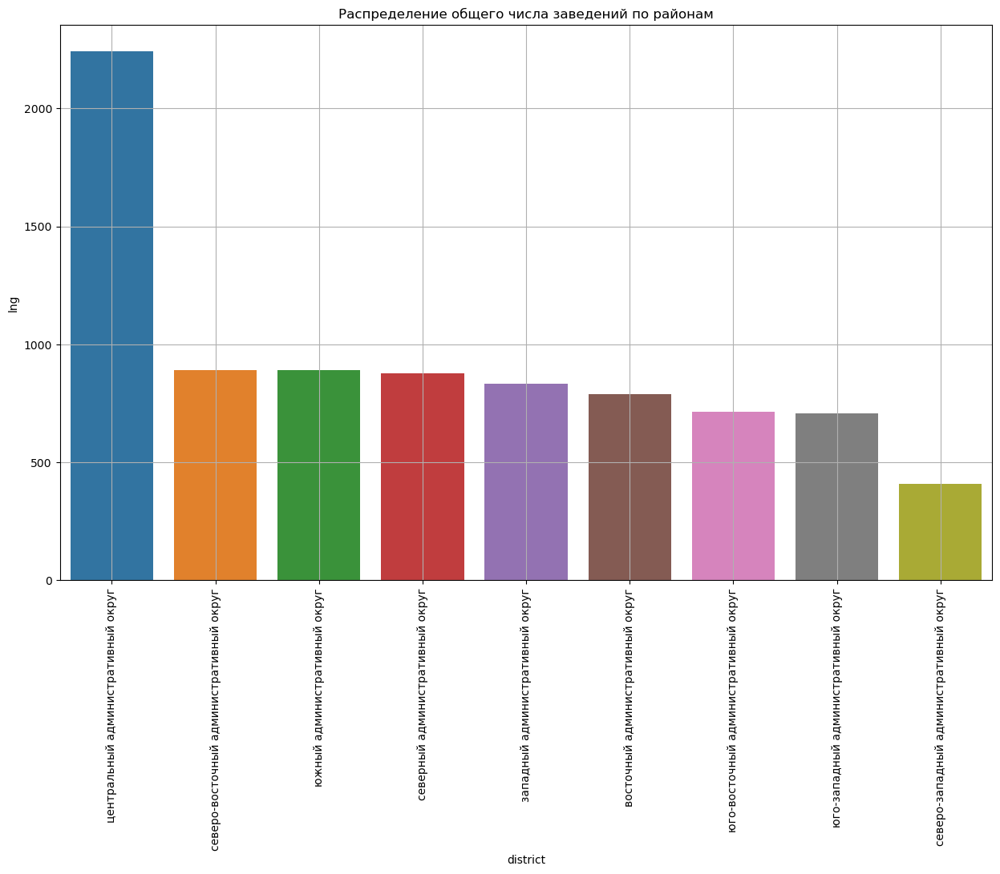

In [22]:
plt.figure(figsize=(15,9))
sns.barplot(data=rest_ao_1,x='district',y='lng')
plt.xticks(rotation = 90)
plt.grid()
plt.title('Распределение общего числа заведений по районам')

In [23]:
fig = px.bar(rest_ao.sort_values(by ='count',ascending = False), 
             x='district',
             y='count',               
             color='category'
            )
fig.update_layout(title='Разбивка заведений по районам',
                   xaxis_title='АО',
                   yaxis_title='категории заведений',  
                   width=900, 
                   height=800
                 )
fig.show()


**Лидером по числу заведений всех типов является ЦАО, неудивительно там скопление туристов и красивых мест, тем самым люди там более часто заходят на чашечку чая). Худшим будет СЗАО.**

### Визуализируйте распределение средних рейтингов по категориям заведений. Сильно ли различаются усреднённые рейтинги в разных типах общепита?

In [24]:
rest_rating = rest.groupby('category')['rating'].mean().reset_index().sort_values(by = 'rating', ascending = False)
rest_rating['rating'] = round(rest_rating['rating'],2)
rest_rating

,category,rating
0,"бар,паб",4.39
5,пиццерия,4.30
6,ресторан,4.29
4,кофейня,4.28
1,булочная,4.27
7,столовая,4.21
3,кафе,4.12
2,быстрое питание,4.05


In [25]:
fig = px.bar(rest_rating, 
             x='category',
             y='rating',               
             color='category'
            )
fig.update_layout(title='Разбиение рейтингов по категориям',
                   xaxis_title='категории',
                   yaxis_title='рейтинг',  
                   width=900, 
                   height=800
                 )
fig.show()

### Постройте фоновую картограмму (хороплет) со средним рейтингом заведений каждого района. Границы районов Москвы.

In [26]:
ao_rating = rest.groupby('district')['rating'].mean().reset_index().sort_values(by='rating', ascending = False)
ao_rating['rating'] = round(ao_rating['rating'],2)
ao_rating

,district,rating
5,центральный административный округ,4.38
2,северный административный округ,4.24
4,северо-западный административный округ,4.21
8,южный административный округ,4.18
1,западный административный округ,4.18
0,восточный административный округ,4.17
7,юго-западный административный округ,4.17
3,северо-восточный административный округ,4.15
6,юго-восточный административный округ,4.10


In [27]:

import json
with open(r"C:\Users\Sergl\OneDrive\Рабочий стол\admin_level_geomap (1).geojson", 'r', encoding='utf-8') as f:
    geo_json = json.load(f)

print(json.dumps(geo_json, indent=2, ensure_ascii=False, sort_keys=True))

{
  "features": [
    {
      "geometry": {
        "coordinates": [
          [
            [
              [
                37.8756653,
                55.825342400000004
              ],
              [
                37.876001599999995,
                55.8249027
              ],
              [
                37.8730967,
                55.8237936
              ],
              [
                37.8689418,
                55.8228697
              ],
              [
                37.869206999999996,
                55.822363200000005
              ],
              [
                37.868322500000005,
                55.822211100000004
              ],
              [
                37.867472,
                55.823703
              ],
              [
                37.86851090000001,
                55.82391880000001
              ],
              [
                37.87046039999999,
                55.8242706
              ],
              [
                37.87172779999

In [28]:
state_geo=geo_json
moscow_lat, moscow_lng = 55.751244, 37.618423


mape = Map(location=[moscow_lat, moscow_lng], zoom_start=17)


Choropleth(
    geo_data=state_geo,
    data=ao_rating,
    columns=['district', 'rating'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.8,
    legend_name='средний рейтинг заведений по районам',
).add_to(mape)


mape

### Отобразите все заведения датасета на карте с помощью кластеров средствами библиотеки folium.

In [29]:
# импортируем карту и маркер
from folium import Map, Marker
# импортируем кластер
from folium.plugins import MarkerCluster

# moscow_lat - широта центра Москвы, moscow_lng - долгота центра Москвы
moscow_lat, moscow_lng = 55.751244, 37.618423

# создаём карту Москвы
mape = Map(location=[moscow_lat, moscow_lng], zoom_start=10)
# создаём пустой кластер, добавляем его на карту
marker_cluster = MarkerCluster().add_to(mape)

# пишем функцию, которая принимает строку датафрейма,
# создаёт маркер в текущей точке и добавляет его в кластер marker_cluster
def create_clusters(row):
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['rating']}",
    ).add_to(marker_cluster)

# применяем функцию create_clusters() к каждой строке датафрейма
rest.apply(create_clusters, axis=1)

# выводим карту
mape

### Найдите топ-15 улиц по количеству заведений. Постройте график распределения количества заведений и их категорий по этим улицам. Попробуйте проиллюстрировать эту информацию одним графиком

In [30]:
top_15_streets = rest.pivot_table(index = 'street', values = 'name', aggfunc = 'count').sort_values(by='name',ascending = False).head(15).reset_index()
top_15_streets


,street,name
0,проспект мира,184
1,профсоюзная улица,122
2,ленинский проспект,107
3,проспект вернадского,97
4,дмитровское шоссе,88
5,каширское шоссе,77
6,варшавское шоссе,76
7,ленинградский проспект,72
8,ленинградское шоссе,70
9,мкад,65


In [31]:
fig = px.bar(top_15_streets, 
             x='name',
             y='street',               
             
            )
fig.update_layout(title='Разбивка заведений по улицам топ 15',
                   xaxis_title='кол-во',
                   yaxis_title='улица',  
                   width=900, 
                   height=800
                 )
fig.show()

In [32]:
street = rest.groupby(['street','category'])['name'].count().reset_index()
display(street)
top_15_streets = street[street['street'].isin(top_15_streets['street'])]
top_15_streets

,street,category,name
0,1-й автозаводский проезд,кафе,1
1,1-й балтийский переулок,ресторан,1
2,1-й варшавский проезд,кафе,1
3,1-й вешняковский проезд,кафе,1
4,1-й волоколамский проезд,кафе,1
...,...,...,...
3814,яузская улица,кофейня,3
3815,яузская улица,ресторан,1
3816,яузский бульвар,"бар,паб",1
3817,яузский бульвар,кафе,1


,street,category,name
698,варшавское шоссе,"бар,паб",6
699,варшавское шоссе,быстрое питание,7
700,варшавское шоссе,кафе,18
701,варшавское шоссе,кофейня,14
702,варшавское шоссе,пиццерия,4
...,...,...,...
3173,улица миклухо-маклая,быстрое питание,4
3174,улица миклухо-маклая,кафе,20
3175,улица миклухо-маклая,кофейня,4
3176,улица миклухо-маклая,пиццерия,2


In [33]:
fig = px.bar(top_15_streets.sort_values(by ='name',ascending = False), 
             x='name',
             y='street',
             color = 'category'
             
            )
fig.update_layout(title='Разбивка заведений по улицам топ 15',
                   xaxis_title='кол-во',
                   yaxis_title='улица',  
                   width=900, 
                   height=800
                 )
fig.show()

In [34]:
top_15_streets_1 = top_15_streets.groupby('street')['name'].sum().reset_index().sort_values(by='name',ascending = False)
top_15_streets_1

,street,name
10,проспект мира,184
11,профсоюзная улица,122
6,ленинский проспект,107
9,проспект вернадского,97
1,дмитровское шоссе,88
2,каширское шоссе,77
0,варшавское шоссе,76
4,ленинградский проспект,72
5,ленинградское шоссе,70
8,мкад,65


Text(0.5, 1.0, 'Распределение общего числа заведений по улицам')

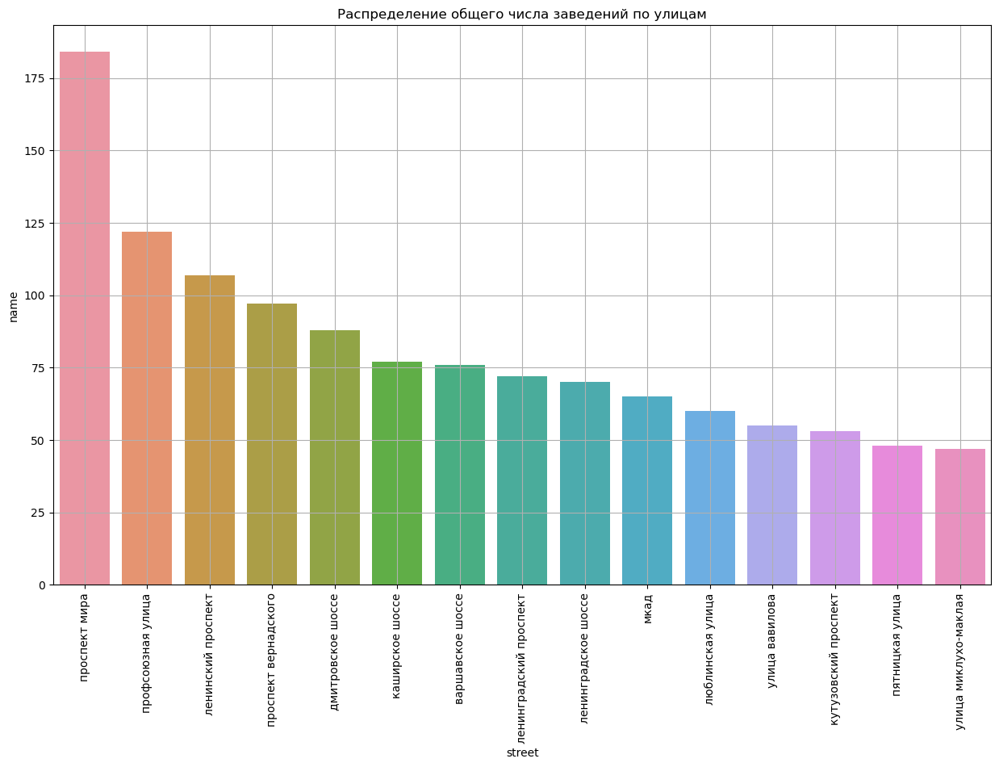

In [35]:
plt.figure(figsize=(15,9))
sns.barplot(data=top_15_streets_1,x='street',y='name')
plt.xticks(rotation = 90)
plt.grid()
plt.title('Распределение общего числа заведений по улицам')

### Найдите улицы, на которых находится только один объект общепита. Что можно сказать об этих заведениях?

In [36]:
street_1 = rest.groupby('street')['name'].count().reset_index()
street_1.columns = ['street','count']
street_1 = street_1[street_1['count']==1]
street_1.head()

,street,count
0,1-й автозаводский проезд,1
1,1-й балтийский переулок,1
2,1-й варшавский проезд,1
3,1-й вешняковский проезд,1
5,1-й голутвинский переулок,1


**Ну вообще улиц на которых только 1 заведение довольно много, порядка 30% всех улиц. Сказать лишь могу, что скорее всего есть  момент устарелых данных, либо же ошибки занесения информации, ведб столько улиц не может быть лишь 1 общепитом, либо имеются иные причины данной проблемы.**

In [37]:
avg_bill_ao = rest.groupby('district')['middle_avg_bill'].median().reset_index().sort_values(by = 'middle_avg_bill',ascending = False)
avg_bill_ao

,district,middle_avg_bill
1,западный административный округ,1000.0
5,центральный административный округ,1000.0
4,северо-западный административный округ,700.0
2,северный административный округ,650.0
7,юго-западный административный округ,600.0
0,восточный административный округ,550.0
3,северо-восточный административный округ,500.0
8,южный административный округ,500.0
6,юго-восточный административный округ,450.0


In [38]:
moscow_lat, moscow_lng = 55.751244, 37.618423


mape = Map(location=[moscow_lat, moscow_lng], zoom_start=17)


Choropleth(
    geo_data=state_geo,
    data=avg_bill_ao,
    columns=['district', 'middle_avg_bill'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.8,
    legend_name='средний чек заведений по районам',
).add_to(mape)


mape

In [39]:
# импортируем карту и маркер
from folium import Map, Marker
# импортируем кластер
from folium.plugins import MarkerCluster

# moscow_lat - широта центра Москвы, moscow_lng - долгота центра Москвы
moscow_lat, moscow_lng = 55.751244, 37.618423

# создаём карту Москвы
mape = Map(location=[moscow_lat, moscow_lng], zoom_start=10)
# создаём пустой кластер, добавляем его на карту
marker_cluster = MarkerCluster().add_to(mape)

# пишем функцию, которая принимает строку датафрейма,
# создаёт маркер в текущей точке и добавляет его в кластер marker_cluster
def create_clusters(row):
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['middle_avg_bill']}",
    ).add_to(marker_cluster)

# применяем функцию create_clusters() к каждой строке датафрейма
rest.apply(create_clusters, axis=1)

# выводим карту
mape

In [40]:
bill_cat = rest.groupby('category')['middle_avg_bill'].median().reset_index().sort_values(by = 'middle_avg_bill', ascending = False)
bill_cat

,category,middle_avg_bill
0,"бар,паб",1250.0
6,ресторан,1250.0
5,пиццерия,600.0
3,кафе,550.0
1,булочная,450.0
4,кофейня,400.0
2,быстрое питание,375.0
7,столовая,300.0


In [41]:
fig = px.bar(bill_cat, 
             x='category',
             y='middle_avg_bill',               
             color='category'
            )
fig.update_layout(title='Разбиение средних чеков по категориям',
                   xaxis_title='категории',
                   yaxis_title='средний чек',  
                   width=900, 
                   height=800
                 )
fig.show()

**Среди всех категориях лидируют бары и рестораны по наибольшему среднему чеку**

In [42]:
bad_rating = rest.query('rating <=3').groupby('category')['middle_avg_bill'].median().reset_index()\
    .sort_values(by = 'middle_avg_bill', ascending = False)
bad_rating

,category,middle_avg_bill
5,пиццерия,900.0
3,кафе,750.0
1,булочная,325.0
2,быстрое питание,325.0
7,столовая,237.5
0,"бар,паб",NaN
4,кофейня,NaN
6,ресторан,NaN


In [43]:
fig = px.bar(bad_rating, 
             x='category',
             y='middle_avg_bill',               
             color='category'
            )
fig.update_layout(title='Разбиение средних чеков по категориям в заведениях с плохим рейтингом',
                   xaxis_title='категории',
                   yaxis_title='средний чек',  
                   width=900, 
                   height=800
                 )
fig.show()

**Удивительная картина для меня, что в заведениях с плохим рейтингом больше всего оставляют в пиццериях, и кафе. Взможно в пабах люди либо не оставляли рейтинги либо же не пойдет туда увидя плохой рейтинг, в ресторанах похожая картина**

### Вывод: <br>
1) В Москве преобладают кафе, рестораны! <br>
2) Больше всего заведений сосредотоцены в центре города в ЦАО <br>
3) Мест больше всего в кафе и ресторанах <br>
4) Несетевых заведений в Москве порядка 62% от общего числа <br>
5) Сетевые места предпочитают булочные и пиццерии <br>
6) Больше всего в Москве Шоколадниц и додо-пицца <br>
7) ЦАО является лидером по кол-ву всех видов общепита <br>
8) Средний рейтинг пользователи ставят примерно одинаковый по всем категориям <br>
9) ЦАО является округом с самыми высокими рейтингами заведений <br>
10) Больше всего заеведений на Проспекте мира и Профсоюзной улице <br>
11) ПОрядка 1/3 улиц имеют только по 1 заведению, рейтинги там хорошие стоит рассмотреть их для открытия заведения. <br>
12) Среднний чек больше всего в центре города и на юго-западе, новый район довольно дорогой в проживании <br>
13) Так же на ужин не сильно влияют рейтинги заведения и кол-во посадочных мест <br>
14) Боьше всего люди оставляют в барах и ресторанах <br>
15) Люди скорее всего не пойдут в рестораны и пабы у которых рейтинг ниже 3

## Детализируем исследование: открытие кофейни

### Сколько всего кофеен в датасете? В каких районах их больше всего, каковы особенности их расположения?


In [44]:
coffi = rest[rest['category']== 'кофейня']
print('В москве ',len(coffi),'Кофейня')

В москве  1401 Кофейня


In [45]:
coffi_ao = rest[rest['category']=='кофейня'].groupby('district')['name'].count().reset_index().sort_values(by='name',ascending = False)
coffi_ao.columns = ['ao','count']
coffi_ao

,ao,count
5,центральный административный округ,428
2,северный административный округ,186
3,северо-восточный административный округ,159
1,западный административный округ,146
8,южный административный округ,131
0,восточный административный округ,104
7,юго-западный административный округ,96
6,юго-восточный административный округ,89
4,северо-западный административный округ,62


In [46]:
fig = px.bar(coffi_ao, 
             x='ao',
             y='count',               
             color='ao'
            )
fig.update_layout(title='Разбиение кофеен по районам',
                   xaxis_title='район',
                   yaxis_title='кол-во кофеен',  
                   width=900, 
                   height=800
                 )
fig.show()

**В Москве порядка 1400 кофеен, наибольшее скопление наблюдается в ЦАО, там люди больше гуляют и любят зайти на чашечку кофе**

### Есть ли круглосуточные кофейни?

In [47]:
coffi_24 = coffi['is_24/7'].sum()
print('24/7 работают ',coffi_24,'кофеен')

24/7 работают  59 кофеен


### Какие у кофеен рейтинги? Как они распределяются по районам?

In [48]:
coffi_ao_rating = coffi.groupby('district')['rating'].mean().reset_index().sort_values(by='rating',ascending = False)
coffi_ao_rating['rating'] = round(coffi_ao_rating['rating'],2)
coffi_ao_rating

,district,rating
5,центральный административный округ,4.34
4,северо-западный административный округ,4.33
2,северный административный округ,4.29
0,восточный административный округ,4.28
7,юго-западный административный округ,4.28
8,южный административный округ,4.23
6,юго-восточный административный округ,4.23
3,северо-восточный административный округ,4.22
1,западный административный округ,4.19


In [52]:
fig = px.bar(coffi_ao_rating, 
             x='district',
             y='rating',               
             color='district'
            )
fig.update_layout(title='Разбиение рейтингов кофеен по районам',
                   xaxis_title='район',
                   yaxis_title='рейтинг',  
                   width=1000, 
                   height=600
                 )
fig.show()

### На какую стоимость чашки капучино стоит ориентироваться при открытии и почему?

In [50]:
price_for_cup = rest.groupby('district')['middle_coffee_cup'].median().reset_index().sort_values(by = 'middle_coffee_cup', ascending = False)
price_for_cup

,district,middle_coffee_cup
7,юго-западный административный округ,197.0
5,центральный административный округ,190.0
1,западный административный округ,185.0
3,северо-восточный административный округ,162.5
2,северный административный округ,159.0
4,северо-западный административный округ,150.0
8,южный административный округ,149.5
6,юго-восточный административный округ,145.0
0,восточный административный округ,135.0


**Стоимость кофе разнится в каждом районе, довольно трудно сказать могу лишь предположить, что в среднес стоит закладывать 220-250 за чашку,для потверждения гипотезы предлагаю построить ящик с усами и увидеть выбросы, и предельную стоимость. В принципе график не опроверг мое предположение**

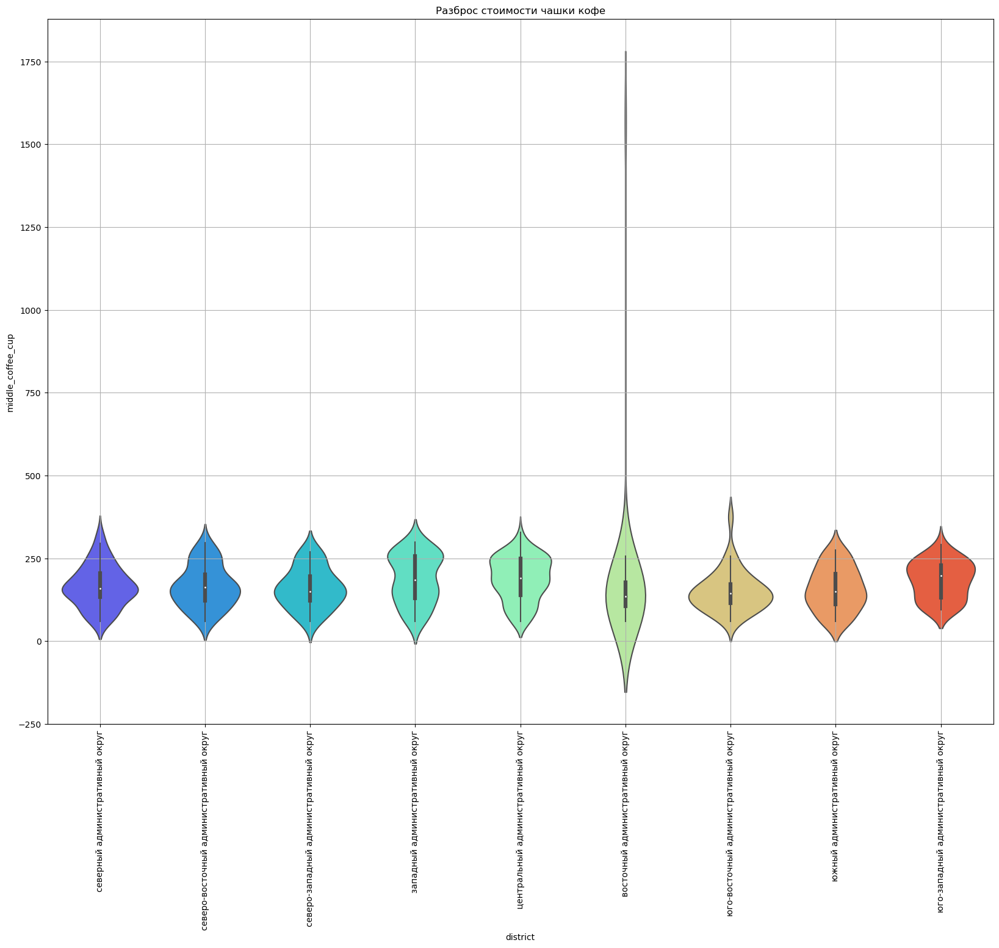

In [51]:
plt.figure(figsize = (20,15))
plt.title('Разброс стоимости чашки кофе')
sns.violinplot(x='district', y='middle_coffee_cup', data=rest, palette= 'rainbow')
plt.xticks(rotation = 90)
plt.grid()

## Рекомендации: <br>
1) Не стоит заморачиваться и октрывать кргулосуточную кофейню, их очень мало среди других, значит они спросом не пользуются. <br>
2) Ориентир нужно делать на среднюю стоимотсь кофе по Москве, в диапазоне 220-250 рублей, чтобы можно было найти клиентов разных сегментов <br>
3) Самые прибыльные места это в ЦАО, однако там и конкруренции больше, стоит понимать, какого формата заведении мы хотим открыть, если обычную кофейню то стоит рассмотреть ЮЗАО, относиельно новый и дорогой район там достаточно мало конкуренов и мы сможем спокойно себя чувствовать.Либо рассмотреть улици где вообще по 1 завдению и подобрать подходящую точку. <br>
4) Однако если же задумка кофейни необыная то однозначно стоит рассматривать центр, чтобы удивить туристов и прохожих.

МЫ проанализировали общепит в Москве и помогли советом как, где и за сколько отрыть кофейню. Начнем с общего представления картины: данные были собраны довольно правильно, в Москве насчитываются порядка 5600 заведений, 9 категорий общепита. Из которых больше всего ресторанов, кафе и кофеен, что недивительно самые нужные места. В среднем на рестораны и пабы и кафе приходится больше посадочных мест, люди там проводят больше времени и это не удивительно. РЫнок Москвы состоит на 62% из не сетевых заведений, это и логично, хотя доля сеток значительна, например в Питере картина была бы другой, там любят все индивидуальное и свое. Сетками пользуются больше всего булочные и пиццерии, где важно имя и репутация заведения. Довольно много сетевых заведений базирииующиеся как кофейни приведены в датасете, так же известные пиццерии (додо, доминос). Если смотреть по АО, то больше всего заведений в ЦАО и ЗАО, ЮАО, так же в ЦАО люди ставят самые высокие рейтинги завдеениям. Я бы рассмотрет для нашей кофейни ЮЗАО, он быстро растет и развивается и конкруренция там меньше. В принципе в центре самые дорогие рестораны, где люди осталвляют больше денег, и стоимость средней чашки кофе там выше. Выяснили, что больше всего завдеений находятся на длинных шоссе с большой пропусконой способностью и человеческим трафиком, там рынок переполнен, лучше открывать на улицах где заведений мало или вообще оно 1, таких порядка 400 улиц в Москве. Так же мы выяснили, что нет зависимости среднего чека и кол-ва посадочных мест на выставляемые людьми рейтинги заведений. И у заведений с плохим рейтингом люди предпочитают оставлять в пиццериях и кафе. Люди в основм ставят хорошие рейтинги во всех районах. ЧТо касается стоимости чашки кофе, то в центре она бужет выше, диапазон для